### This notebook was used to confirm if the observed decreases of gyre transport actually corresponded to state transitions

In [1]:
include("AuxiliaryFunctions/BornModel.jl")
include("AuxiliaryFunctions/Plotting.jl")
include("AuxiliaryFunctions/NoiseAuxiliaryFunctions.jl")

import .BornModel as BM
import .Plotting as P
import .NoiseAuxiliaryFunctions as NAF

using Plots, Plots.PlotMeasures
using DifferentialEquations
using BifurcationKit, Parameters
using Statistics
using KernelDensity


┌ Warning: Error requiring `KrylovKit` from `LinearSolve`
│   exception = (LoadError("C:\\Users\\kvdhe\\.julia\\packages\\LinearSolve\\qCLK7\\ext\\LinearSolveKrylovKitExt.jl", 1, ArgumentError("Package LinearSolve does not have KrylovKit in its dependencies:\n- You may have a partially installed environment. Try `Pkg.instantiate()`\n  to ensure all packages in the environment are installed.\n- Or, if you have LinearSolve checked out for development and have\n  added KrylovKit as a dependency but haven't updated your primary\n  environment's manifest file, try `Pkg.resolve()`.\n- Otherwise you may need to report an issue with LinearSolve")), Union{Ptr{Nothing}, Base.InterpreterIP}[Ptr{Nothing} @0x000001a7bb78ac89, Ptr{Nothing} @0x000001a7bb78aeea, Ptr{Nothing} @0x00007ff848cc6a24, Ptr{Nothing} @0x00007ff848cc861e, Ptr{Nothing} @0x00007ff848cc7ddc, Ptr{Nothing} @0x00007ff848cc7f96, Ptr{Nothing} @0x00007ff848cc920e, Ptr{Nothing} @0x00007ffff51a2aba, Ptr{Nothing} @0x00007ffff4ff3b02, Ptr{N

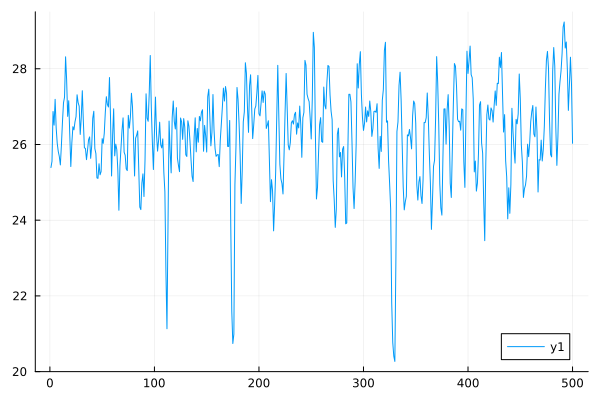

In [362]:
# set noise, parameters, x0
noisevec = [0, BM.nondimensional_S(0.5), 0]
noise_seed = seed

pars_F05_S35_σS05 = (T2 = BM.nondimensional_T(10.), S2 = BM.nondimensional_S(35.), T4 = BM.nondimensional_T(4.), S4 = BM.nondimensional_S(34.9), T0 = BM.nondimensional_T(1.6), Tamp = 0,
    η = 1.29e2, μ1 = 0.838,μ2 = 83.8, μ3 = 12.1, μ4 = BM.nondimensional_F(0.5), r = 0.0714, τT0 = 0, τS2 = 1, τF = 0)

pars_F1_S35_σS05 = (T2 = BM.nondimensional_T(10.), S2 = BM.nondimensional_S(35.), T4 = BM.nondimensional_T(4.), S4 = BM.nondimensional_S(34.9), T0 = BM.nondimensional_T(1.6), Tamp = 0,
    η = 1.29e2, μ1 = 0.838,μ2 = 83.8, μ3 = 12.1, μ4 = BM.nondimensional_F(1.), r = 0.0714, τT0 = 0, τS2 = 1, τF = 0)

pars_F15_S35_σS05 = (T2 = BM.nondimensional_T(10.), S2 = BM.nondimensional_S(35.), T4 = BM.nondimensional_T(4.), S4 = BM.nondimensional_S(34.9), T0 = BM.nondimensional_T(1.6), Tamp = 0,
    η = 1.29e2, μ1 = 0.838,μ2 = 83.8, μ3 = 12.1, μ4 = BM.nondimensional_F(1.5), r = 0.0714, τT0 = 0, τS2 = 1, τF = 0)

pars_F05_S3475_σS05 = (T2 = BM.nondimensional_T(10.), S2 = BM.nondimensional_S(34.75), T4 = BM.nondimensional_T(4.), S4 = BM.nondimensional_S(34.9), T0 = BM.nondimensional_T(1.6), Tamp = 0,
    η = 1.29e2, μ1 = 0.838,μ2 = 83.8, μ3 = 12.1, μ4 = BM.nondimensional_F(0.5), r = 0.0714, τT0 = 0, τS2 = 1, τF = 0)

pars_F1_S3475_σS05 = (T2 = BM.nondimensional_T(10.), S2 = BM.nondimensional_S(34.75), T4 = BM.nondimensional_T(4.), S4 = BM.nondimensional_S(34.9), T0 = BM.nondimensional_T(1.6), Tamp = 0,
    η = 1.29e2, μ1 = 0.838,μ2 = 83.8, μ3 = 12.1, μ4 = BM.nondimensional_F(1.), r = 0.0714, τT0 = 0, τS2 = 1, τF = 0)

pars_F15_S3475_σS05 = (T2 = BM.nondimensional_T(10.), S2 = BM.nondimensional_S(34.75), T4 = BM.nondimensional_T(4.), S4 = BM.nondimensional_S(34.9), T0 = BM.nondimensional_T(1.6), Tamp = 0,
    η = 1.29e2, μ1 = 0.838,μ2 = 83.8, μ3 = 12.1, μ4 = BM.nondimensional_F(1.5), r = 0.0714, τT0 = 0, τS2 = 1, τF = 0)

pars = pars_F05_S35_σS05

x0 = [BM.nondimensional_T(6), BM.nondimensional_S(35.5), BM.nondimensional_T(5), BM.nondimensional_S(35.5), 0, 0, 0]

# integration settings
spinup = 10
n_years = 500 + spinup #5000

seed = 111

timesteps_per_year = 3650
dt = (1/timesteps_per_year)
tspan = (0., n_years)

end_of_spinup = 10

function integrate()
# integrate
    sdeprob = SDEProblem(BM.stochastic_nondimensional_born!, BM.noisefunction(noisevec), x0, tspan, pars)
    sol = solve(sdeprob, EM(), dt = dt, seed = noise_seed)

    t = sol.t .- end_of_spinup

    offset = 2 #length(sol) % timesteps_per_year
    output_sol, output_t = sol[end_of_spinup*timesteps_per_year + offset:end], t[end_of_spinup*timesteps_per_year + offset:end]
    output_M = BM.dimensional_M(BM.calculate_M(output_sol, pars))

    T1 = output_sol[1, :]
    S1 = output_sol[2, :]
    T3 = output_sol[3, :]
    S3 = output_sol[4, :]

    M_yearly = zeros(Int(tspan[2]) - end_of_spinup)
    T1_yearly = zeros(Int(tspan[2]) - end_of_spinup)
    S1_yearly = zeros(Int(tspan[2]) - end_of_spinup)
    T3_yearly = zeros(Int(tspan[2]) - end_of_spinup)
    S3_yearly = zeros(Int(tspan[2]) - end_of_spinup)

    if length(output_M) > (n_years - end_of_spinup) * timesteps_per_year - 10
        for i in 1:length(M_yearly)
            M_yearly[i] = mean(output_M[(i-1) * timesteps_per_year + 1:(i*timesteps_per_year)])

            T1_yearly[i] = mean(output_sol[1, (i-1) * timesteps_per_year + 1:(i*timesteps_per_year)])
            S1_yearly[i] = mean(output_sol[2, (i-1) * timesteps_per_year + 1:(i*timesteps_per_year)])
            T3_yearly[i] = mean(output_sol[3, (i-1) * timesteps_per_year + 1:(i*timesteps_per_year)])
            S3_yearly[i] = mean(output_sol[4, (i-1) * timesteps_per_year + 1:(i*timesteps_per_year)])

        end
    end

    # return output_M, T1, S1, T3, S3
    return M_yearly, T1_yearly, S1_yearly, T3_yearly, S3_yearly
end

# M, T1, S1, T3, S3 = integrate();
M_yearly, T1_yearly, S1_yearly, T3_yearly, S3_yearly = integrate();

# plot(M)
plot(M_yearly)



In [363]:
threshold = 21

index = []
for i in 2:length(M_yearly)
    if M_yearly[i] < threshold
        push!(index, i)
    end 
end

min_index = []
for i in 1:length(index)-1
    if index[i + 1] - index[i] > 1
        push!(min_index, index[i])
    end 
end 

In [365]:
index1 = min_index[1] -1 

# integrate again from this point; this time, no noise
noisevec = [0, 0, 0]
x0  = [T1_yearly[index1], S1_yearly[index1], T3_yearly[index1], S3_yearly[index1], 0, 0, 0]

n_years = 50
timesteps_per_year = 3650
dt = (1/timesteps_per_year)
tspan = (0., n_years)

sdeprob = SDEProblem(BM.stochastic_nondimensional_born!, BM.noisefunction(noisevec), x0, tspan, pars)
sol = solve(sdeprob, EM(), dt = dt, seed = noise_seed)

M_nonoise_low = BM.dimensional_M(BM.calculate_M(sol, pars))

### branch one year later
index2 = index1 + 1

# integrate again from this point; this time, no noise
noisevec = [0, 0, 0]
x0  = [T1_yearly[index2], S1_yearly[index2], T3_yearly[index2], S3_yearly[index2], 0, 0, 0]

n_years = 50
timesteps_per_year = 3650
dt = (1/timesteps_per_year)
tspan = (0., n_years)

sdeprob = SDEProblem(BM.stochastic_nondimensional_born!, BM.noisefunction(noisevec), x0, tspan, pars)
sol = solve(sdeprob, EM(), dt = dt, seed = noise_seed)

M_nonoise_high = BM.dimensional_M(BM.calculate_M(sol, pars));

### plot
p = plot(grid = false)

plot!(1:length(M_yearly), M_yearly, lab = "stochastic integration", color = "black")
plot!(index1 .+ sol.t, M_nonoise_low, lab =  "deterministic branch (year $index1)", color =  "dodgerblue", lw = 2, ls = :dash)
plot!(index2 .+ sol.t, M_nonoise_high, lab =  "deterministic branch (year $index2)", color =  "dodgerblue", lw = 2)

xmin = floor(index1 / 50) * 50
xlims!(xmin, xmin + 100)
xlabel!("time (model yr)")
ylabel!("M (Sv)")

In [351]:
# figure with four simulations for param set B

function plot_branch(index1)
    # i1 = min_index[2]

    # integrate again from this point; this time, no noise
    noisevec = [0, 0, 0]
    x0  = [T1_yearly[index1], S1_yearly[index1], T3_yearly[index1], S3_yearly[index1], 0, 0, 0]

    n_years = 50
    timesteps_per_year = 3650
    dt = (1/timesteps_per_year)
    tspan = (0., n_years)

    sdeprob = SDEProblem(BM.stochastic_nondimensional_born!, BM.noisefunction(noisevec), x0, tspan, pars)
    sol = solve(sdeprob, EM(), dt = dt, seed = noise_seed)

    M_nonoise_low = BM.dimensional_M(BM.calculate_M(sol, pars))

    ### branch one year later
    index2 = index1 + 1

    # integrate again from this point; this time, no noise
    noisevec = [0, 0, 0]
    x0  = [T1_yearly[index2], S1_yearly[index2], T3_yearly[index2], S3_yearly[index2], 0, 0, 0]

    n_years = 50
    timesteps_per_year = 3650
    dt = (1/timesteps_per_year)
    tspan = (0., n_years)

    sdeprob = SDEProblem(BM.stochastic_nondimensional_born!, BM.noisefunction(noisevec), x0, tspan, pars)
    sol = solve(sdeprob, EM(), dt = dt, seed = noise_seed)

    M_nonoise_high = BM.dimensional_M(BM.calculate_M(sol, pars));

    ### plot
    p = plot(grid = false)

    plot!(1:length(M_yearly), M_yearly, lab = "stochastic integration", color = "black")
    plot!(index1 .+ sol.t, M_nonoise_low, lab =  "deterministic branch (year $index1)", color =  "dodgerblue", lw = 2, ls = :dash)
    plot!(index2 .+ sol.t, M_nonoise_high, lab =  "deterministic branch (year $index2)", color =  "dodgerblue", lw = 2)

    xmin = floor(index1 / 50) * 50
    xlims!(xmin, xmin + 100)
    xlabel!("time (model yr)")
    ylabel!("M (Sv)")

    return p 
end

p1 = plot_branch(min_index[1])
title!("a.")
p2 = plot_branch(min_index[2])
title!("b.")
p3 = plot_branch(min_index[3])
title!("c.")
p4 = plot_branch(min_index[4])
title!("d.")
# p5 = plot_branch(min_index[5])
# p6 = plot_branch(min_index[6])

plot(p1, p2, p3, p4, 
    layout = (6, 1),
    size = (width = 1100, height = 1000))


In [ ]:

# output_F05_S35_σS05 = NAF.integration(pars_F05_S35_σS05, noisevec, seed, n_years, spinup)

# pars_F1_S35_σS05 = (T2 = BM.nondimensional_T(10.), S2 = BM.nondimensional_S(35.), T4 = BM.nondimensional_T(4.), S4 = BM.nondimensional_S(34.9), T0 = BM.nondimensional_T(1.6), Tamp = 0,
#     η = 1.29e2, μ1 = 0.838,μ2 = 83.8, μ3 = 12.1, μ4 = BM.nondimensional_F(1.), r = 0.0714, τT0 = 0, τS2 = 1, τF = 0)
# output_F1_S35_σS05 = NAF.integration(pars_F1_S35_σS05, noisevec, seed, n_years, spinup)

# pars_F15_S35_σS05 = (T2 = BM.nondimensional_T(10.), S2 = BM.nondimensional_S(35.), T4 = BM.nondimensional_T(4.), S4 = BM.nondimensional_S(34.9), T0 = BM.nondimensional_T(1.6), Tamp = 0,
#     η = 1.29e2, μ1 = 0.838,μ2 = 83.8, μ3 = 12.1, μ4 = BM.nondimensional_F(1.5), r = 0.0714, τT0 = 0, τS2 = 1, τF = 0)
# output_F15_S35_σS05 = NAF.integration(pars_F15_S35_σS05, noisevec, seed, n_years, spinup)

# pars_F05_S3475_σS05 = (T2 = BM.nondimensional_T(10.), S2 = BM.nondimensional_S(34.75), T4 = BM.nondimensional_T(4.), S4 = BM.nondimensional_S(34.9), T0 = BM.nondimensional_T(1.6), Tamp = 0,
#     η = 1.29e2, μ1 = 0.838,μ2 = 83.8, μ3 = 12.1, μ4 = BM.nondimensional_F(0.5), r = 0.0714, τT0 = 0, τS2 = 1, τF = 0)
# output_F05_S3475_σS05 = NAF.integration(pars_F05_S3475_σS05, noisevec, seed, n_years, spinup)

# pars_F1_S3475_σS05 = (T2 = BM.nondimensional_T(10.), S2 = BM.nondimensional_S(34.75), T4 = BM.nondimensional_T(4.), S4 = BM.nondimensional_S(34.9), T0 = BM.nondimensional_T(1.6), Tamp = 0,
#     η = 1.29e2, μ1 = 0.838,μ2 = 83.8, μ3 = 12.1, μ4 = BM.nondimensional_F(1.), r = 0.0714, τT0 = 0, τS2 = 1, τF = 0)
# output_F1_S3475_σS05 = NAF.integration(pars_F1_S3475_σS05, noisevec, seed, n_years, spinup)

# pars_F15_S3475_σS05 = (T2 = BM.nondimensional_T(10.), S2 = BM.nondimensional_S(34.75), T4 = BM.nondimensional_T(4.), S4 = BM.nondimensional_S(34.9), T0 = BM.nondimensional_T(1.6), Tamp = 0,
#     η = 1.29e2, μ1 = 0.838,μ2 = 83.8, μ3 = 12.1, μ4 = BM.nondimensional_F(1.5), r = 0.0714, τT0 = 0, τS2 = 1, τF = 0)
# output_F15_S3475_σS05 = NAF.integration(pars_F15_S3475_σS05, noisevec, seed, n_years, spinup)
